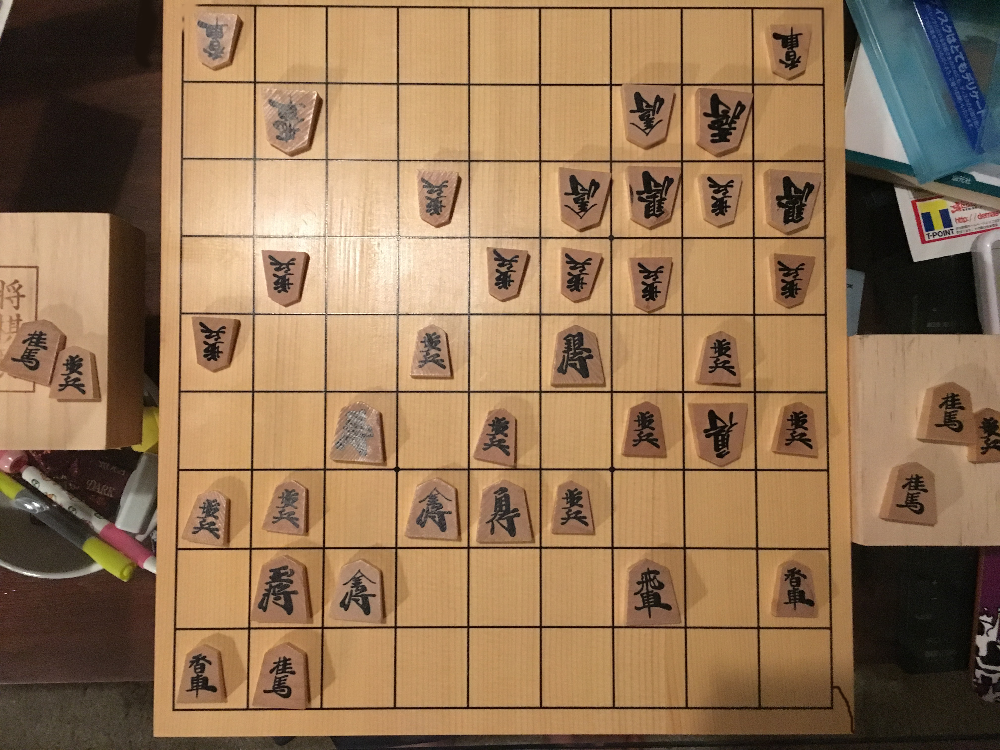

In [51]:
import cv2
import numpy as np
import itertools
from IPython.display import display, Image
import glob

def display_cv_image(image, format='.png'):
    decoded_bytes = cv2.imencode(format, image)[1].tobytes()
    display(Image(data=decoded_bytes))

files = sorted(glob.glob('../images/manual_trim/*'))
raw_imgs = [cv2.imread(f) for f in files]
display_cv_image(raw_imgs[1])

In [52]:
import shogicam
import shogicam.util

rect, score = shogicam.corners(raw_imgs[0])

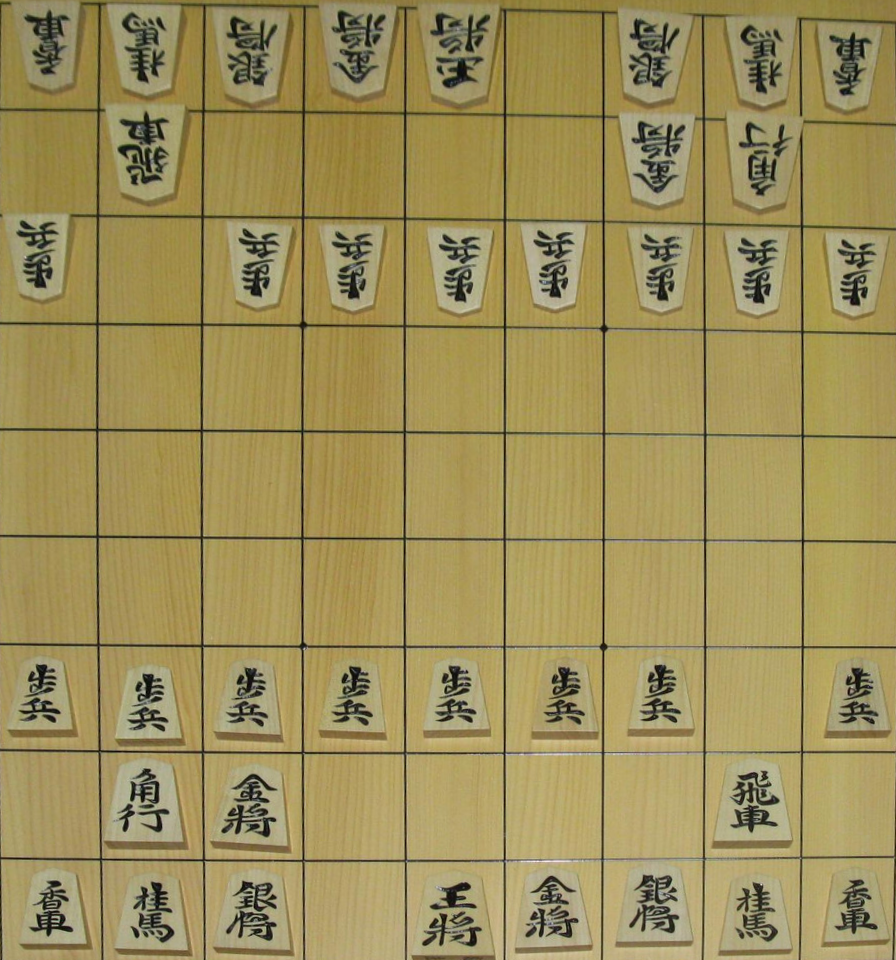

In [53]:
BASE_SIZE = 64
def trim(img, corners, show=True):
    w = BASE_SIZE * 14
    h = BASE_SIZE * 15
    transform = cv2.getPerspectiveTransform(np.float32(corners), np.float32([[0, 0], [w, 0], [w, h], [0, h]]))
    normed = cv2.warpPerspective(img, transform, (w, h))
    if show:
        display_cv_image(normed)
    return normed

img = trim(raw_imgs[0], rect)

In [56]:
img_rows, img_cols = 64, 64
def cells(img):
    dx = img.shape[0] / 9
    dy = img.shape[1] / 9
    for i in range(9):
        for j in range(9):
            sx = int(dx * i)
            sy = int(dy * j)
            yield normalize(img[sx:(int(sx + dx)), sy:(int(sy + dy))], img_rows, img_cols)

# h * w / gray
def normalize(img, h, w):
    size = img.shape[:2]
    f = min(h / size[0], w / size[1])
    resized = cv2.resize(img, (int(size[1] * f), int(size[0] * f)), interpolation=cv2.INTER_AREA)

    gray = cv2.cvtColor(resized, cv2.COLOR_BGR2GRAY)
    blank = np.full((h, w), np.uint8(255), dtype=np.uint8)
    hstart = int((h - gray.shape[0]) / 2)
    wstart = int((w - gray.shape[1]) / 2)
    blank[hstart:(hstart + gray.shape[0]), wstart:(wstart + gray.shape[1])] = gray
    return blank

cell_imgs = np.array(list(cells(img)))
cell_imgs = cell_imgs.reshape(cell_imgs.shape[0], img_rows, img_cols, 1)
cell_imgs = cell_imgs.astype(np.float32)
cell_imgs /= 255
print(cell_imgs.shape)

(81, 64, 64, 1)


In [42]:
from keras import backend as K
from keras.layers import Conv2D, MaxPooling2D, Input
from keras.layers import Dense, Dropout, Flatten
from keras.layers.merge import Concatenate
from keras.models import Sequential, Model

input_shape = (img_rows, img_cols, 1)
img_rows, img_cols = 64, 64
labels = ['gyoku', 'ou', 'kin', 'gin', 'kei', 'kyo', 'kaku', 'hi', 'fu', 'narigin', 'narikei', 'narikyo', 'uma', 'ryu', 'to']
num_classes = len(labels) * 2 + 1

model = Sequential()
model.add(Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.2))

model.add(Conv2D(64, kernel_size=(3, 3), activation='relu', input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.3))

model.add(Conv2D(128, kernel_size=(3, 3), activation='relu', input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.4))

model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(256, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(num_classes, activation='softmax'))

model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 62, 62, 32)        320       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 31, 31, 32)        0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 31, 31, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 29, 29, 64)        18496     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 14, 14, 64)        0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 14, 14, 64)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 12, 12, 128)       73856     
__________

In [43]:
model.load_weights("../learn/param.hdf5")

In [57]:
y = model.predict(cell_imgs)
y_max = np.array([np.argmax(c) for c in y])

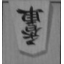

*kyo


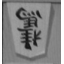

*kei


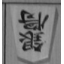

*gin


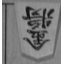

*kin


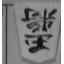

*gyoku


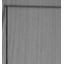

space


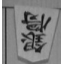

*gin


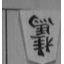

kaku


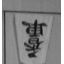

*kyo


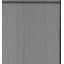

space


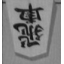

*ryu


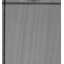

space


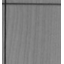

space


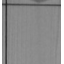

space


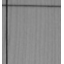

space


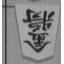

*kin


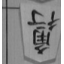

uma


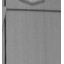

space


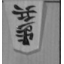

*fu


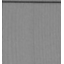

space


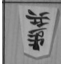

*fu


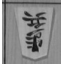

*fu


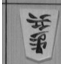

*fu


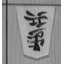

*fu


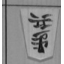

*to


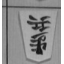

*fu


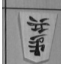

*fu


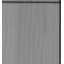

space


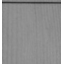

space


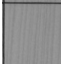

space


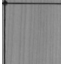

space


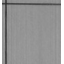

space


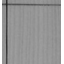

space


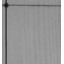

space


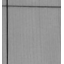

space


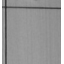

space


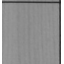

space


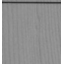

space


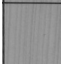

space


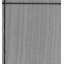

space


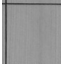

space


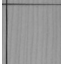

space


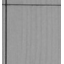

space


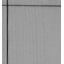

space


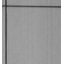

space


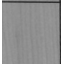

space


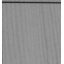

space


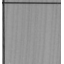

space


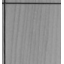

space


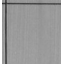

space


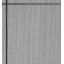

space


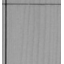

space


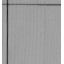

space


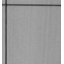

space


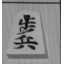

fu


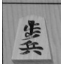

fu


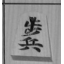

fu


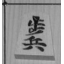

fu


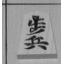

fu


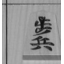

uma


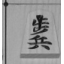

uma


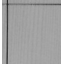

space


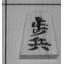

uma


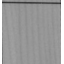

space


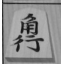

kaku


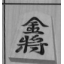

kin


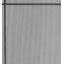

space


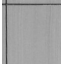

space


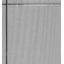

space


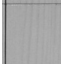

space


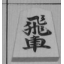

hi


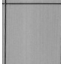

space


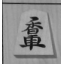

kyo


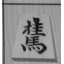

kei


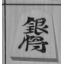

kaku


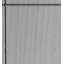

space


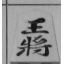

ou


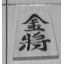

kin


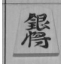

kaku


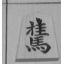

kei


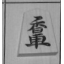

*ryu


In [58]:
def label_name(idx):
    if len(labels) > idx:
        return labels[idx]
    elif len(labels) * 2 > idx:
        return "*" + labels[idx - len(labels)]
    else:
        return "space"

for i in range(len(cell_imgs)):
    display_cv_image(np.uint8(cell_imgs[i] * 255)[:, :, 0])
    print(label_name(y_max[i]))